In [1]:
import pandas as pd
import numpy as np
import math
%matplotlib inline
import matplotlib.pyplot as plt

In [27]:
experiments = 5
epochs = 100

activations = ['sigmoid', 'tanh', 'relu', 'elu', 'selu', 'softplus', 'softsign', 'hard_sigmoid', 'LeakyReLU', 'ThresholdedReLU']
optimizers = ['rmsp', 'adam', 'sgd', 'Adagrad', 'Adadelta', 'Adamax', 'Nadam']
colors = ['#000000', '#330000', '#660000', '#990000', '#CC0000', '#FF0000',
          '#003300', '#006600', '#009900', '#00CC00', '#00FF00',
          '#000033', '#000066', '#000099', '#0000CC', '#0000FF',
          '#033000', '#066000', '#099000', '#0CC000', '#0FF000',
          '#000330', '#000660', '#000990', '#000CC0', '#000FF0']
colors_new = ['#FF0000', '#FF8000', '#00AA00', '#0000FF', '#7F00FF', 'k', 'y', 'm', 'c', '#CC0066', '#6600CC', '#066000', '#000000']
colors_opt = ['#FF0000', '#FF8000', '#00AA00', '#0000FF', '#7F00FF', 'k', 'y', 'm', 'c', '#CC0066', '#6600CC', '#066000', '#000000']
lines = ['-', '--', ':', '-.']
cols_f = []
for c in colors:
    for l in lines:
        cols_f.append(c+l)
        
columns=['epoch', 'acc', 'loss', 'val_acc', 'val_loss']

configs = [

    { 'optimizer': 'sgd', 'momentum': 0.1, 'decay': 0.0, 'nesterov': False },
    { 'optimizer': 'sgd', 'momentum': 0.9, 'decay': 0.0, 'nesterov': False },
    { 'optimizer': 'sgd', 'momentum': 0.95, 'decay': 0.0, 'nesterov': False },
    { 'optimizer': 'sgd', 'momentum': 0.99, 'decay': 0.0, 'nesterov': False },
    { 'optimizer': 'sgd', 'momentum': 0.999, 'decay': 0.0, 'nesterov': False },

    { 'optimizer': 'sgd', 'momentum': 0.0, 'decay': 0.0, 'nesterov': True },
    { 'optimizer': 'sgd', 'momentum': 0.1, 'decay': 0.0, 'nesterov': True },
    { 'optimizer': 'sgd', 'momentum': 0.9, 'decay': 0.0, 'nesterov': True },
    { 'optimizer': 'sgd', 'momentum': 0.95, 'decay': 0.0, 'nesterov': True },
    { 'optimizer': 'sgd', 'momentum': 0.99, 'decay': 0.0, 'nesterov': True },
    { 'optimizer': 'sgd', 'momentum': 0.999, 'decay': 0.0, 'nesterov': True },
    
    { 'optimizer': 'rmsp', 'rho': 0.5, 'decay': 0.0 },
    { 'optimizer': 'rmsp', 'rho': 0.99, 'decay': 0.0 },
    { 'optimizer': 'rmsp', 'rho': 0.95, 'decay': 0.0 },
    { 'optimizer': 'rmsp', 'rho': 0.999, 'decay': 0.0 },
    { 'optimizer': 'rmsp', 'rho': 0.9999, 'decay': 0.0 },

    { 'optimizer': 'Adadelta', 'rho': 0.5, 'decay': 0.0 },
    { 'optimizer': 'Adadelta', 'rho': 0.9, 'decay': 0.0 },
    { 'optimizer': 'Adadelta', 'rho': 0.99, 'decay': 0.0 },
    { 'optimizer': 'Adadelta', 'rho': 0.999, 'decay': 0.0 },
    { 'optimizer': 'Adadelta', 'rho': 0.9999, 'decay': 0.0 },
    
    { 'optimizer': 'adam', 'amsgrad': False, 'beta_1': 0.95, 'beta_2': 0.9999, 'decay': 0.0 },
    { 'optimizer': 'adam', 'amsgrad': False, 'beta_1': 0.9, 'beta_2': 0.999, 'decay': 0.0 },
    { 'optimizer': 'adam', 'amsgrad': False, 'beta_1': 0.95, 'beta_2': 0.999, 'decay': 0.0 },
    { 'optimizer': 'adam', 'amsgrad': False, 'beta_1': 0.9, 'beta_2': 0.9999, 'decay': 0.0 },
    { 'optimizer': 'adam', 'amsgrad': True, 'beta_1': 0.95, 'beta_2': 0.9999, 'decay': 0.0 },
    { 'optimizer': 'adam', 'amsgrad': True, 'beta_1': 0.9, 'beta_2': 0.999, 'decay': 0.0 },
    { 'optimizer': 'adam', 'amsgrad': True, 'beta_1': 0.95, 'beta_2': 0.999, 'decay': 0.0 },
    { 'optimizer': 'adam', 'amsgrad': True, 'beta_1': 0.9, 'beta_2': 0.9999, 'decay': 0.0 },
    
    { 'optimizer': 'Adamax', 'beta_1': 0.99, 'beta_2': 0.9999, 'decay': 0.0 },    
    { 'optimizer': 'Adamax', 'beta_1': 0.99, 'beta_2': 0.999, 'decay': 0.0 },    
    { 'optimizer': 'Adamax', 'beta_1': 0.95, 'beta_2': 0.999, 'decay': 0.0 },      
    { 'optimizer': 'Adamax', 'beta_1': 0.95, 'beta_2': 0.99, 'decay': 0.0 },      
    { 'optimizer': 'Adamax', 'beta_1': 0.95, 'beta_2': 0.95, 'decay': 0.0 },      
    { 'optimizer': 'Adamax', 'beta_1': 0.9, 'beta_2': 0.9, 'decay': 0.0 },    
    { 'optimizer': 'Adamax', 'beta_1': 0.9, 'beta_2': 0.99, 'decay': 0.0 },    
    { 'optimizer': 'Adamax', 'beta_1': 0.9, 'beta_2': 0.95, 'decay': 0.0 },        
    
    { 'optimizer': 'Nadam', 'beta_1': 0.9, 'beta_2': 0.99, 'schedule_decay': 0.004 },        
    { 'optimizer': 'Nadam', 'beta_1': 0.95, 'beta_2': 0.999, 'schedule_decay': 0.004 },        
    { 'optimizer': 'Nadam', 'beta_1': 0.95, 'beta_2': 0.99, 'schedule_decay': 0.004 },        
    { 'optimizer': 'Nadam', 'beta_1': 0.95, 'beta_2': 0.95, 'schedule_decay': 0.004 },        
    { 'optimizer': 'Nadam', 'beta_1': 0.95, 'beta_2': 0.9, 'schedule_decay': 0.004 },        
    { 'optimizer': 'Nadam', 'beta_1': 0.9, 'beta_2': 0.9, 'schedule_decay': 0.004 },        
    { 'optimizer': 'Nadam', 'beta_1': 0.9, 'beta_2': 0.95, 'schedule_decay': 0.004 },        

]


In [29]:
def data_label(prefix):
    if prefix == 'normd':
        return 'Normalized data'
    elif prefix == 'std_sample_wise':
        return 'Standardized data'

def load_data(path, prefix, activations, optimizers, experiments, units):
    data = []
    i = 1
    for act in activations:
        for opt in optimizers:
            
            print(' ' * 100, end='\r')
            print('Loading data for combination %d of %d' % (i, len(activations) * len(optimizers)), end='\r')
            
            data.append({
                'name': 'Activation: %s, Optimizer: %s, %s' % (act, opt, data_label(prefix)),
                'col': colors[i % len(colors)],
                'line': lines[i % len(lines)],
                'act': act,
                'opt':opt,
                'opt_cfg': 'Default',
                'data_type': prefix,
                'data' : [pd.read_csv(path + prefix + '_' + act +'_' + opt + '_' + str(ex)  + '_' + str(units) + '.csv') for ex in range(experiments)],
                'max_val_acc':{},

            })
            i+=1
            
    return data

def load_custom_data(path, prefix, configs, experiments, units):
    data = []
    i = 1
    for act in activations:
        for cfg in configs:
            
            print(' ' * 100, end='\r')
            print('Loading data for combination %d of %d' % (i, len(activations) * len(configs)), end='\r')
            
            if cfg['optimizer'] == 'sgd':
                opt_name = 'Momentum: %s, Nesterov: %s' % (str(cfg['momentum']), str(cfg['nesterov']))
                name = 'Activation: %s, Optimizer: %s, %s, %s' % (act, cfg['optimizer'], opt_name, data_label(prefix))
                file_name = '_'.join([prefix, act, cfg['optimizer'], 
                                           str(cfg['momentum']), str(cfg['decay']), 
                                           str(cfg['nesterov'])])
                
            elif cfg['optimizer'] == 'rmsp':
                opt_name = 'rho: %s' % (str(cfg['rho']))
                name = 'Activation: %s, Optimizer: %s, %s, %s' % (act, cfg['optimizer'], opt_name, data_label(prefix))
                file_name = '_'.join([prefix, act, cfg['optimizer'], 
                                       str(cfg['rho']), str(cfg['decay'])])
                
            elif cfg['optimizer'] == 'Adadelta':
                opt_name = 'rho: %s' % (str(cfg['rho']))
                name = 'Activation: %s, Optimizer: %s, %s, %s' % (act, cfg['optimizer'], opt_name, data_label(prefix))
                file_name = '_'.join([prefix, act, cfg['optimizer'], 
                                       str(cfg['rho']), str(cfg['decay'])])
            
            elif cfg['optimizer'] == 'adam':
                opt_name = 'amsgrad: %s, beta_1: %s, beta_2: %s' % (str(cfg['amsgrad']), str(cfg['beta_1']), str(cfg['beta_2']))
                name = 'Activation: %s, Optimizer: %s, %s, %s' % (act, cfg['optimizer'], opt_name, data_label(prefix))
                file_name = '_'.join([prefix, act, cfg['optimizer'], 
                                       str(cfg['amsgrad']), str(cfg['beta_1']), str(cfg['beta_2']), str(cfg['decay'])])
                
            elif cfg['optimizer'] == 'Adagrad':
                opt_name = ''
                name = 'Activation: %s, Optimizer: %s, %s, %s' % (act, cfg['optimizer'], opt_name, data_label(prefix))
                file_name = '_'.join([prefix, act, cfg['optimizer'], 
                                       str(cfg['decay'])])
                
            elif cfg['optimizer'] == 'Adamax':
                opt_name = 'beta_1: %s, beta_2: %s' % (str(cfg['beta_1']), str(cfg['beta_2']))
                name = 'Activation: %s, Optimizer: %s, %s, %s' % (act, cfg['optimizer'], opt_name, data_label(prefix))
                file_name = '_'.join([prefix, act, cfg['optimizer'], 
                                       str(cfg['beta_1']), str(cfg['beta_2']), str(cfg['decay'])])
                
            elif cfg['optimizer'] == 'Nadam':
                opt_name = 'beta_1: %s, beta_2: %s' % (str(cfg['beta_1']), str(cfg['beta_2']))
                name = 'Activation: %s, Optimizer: %s, %s, %s' % (act, cfg['optimizer'], opt_name, data_label(prefix))
                file_name = '_'.join([prefix, act, cfg['optimizer'], 
                                       str(cfg['beta_1']), str(cfg['beta_2']), str(cfg['schedule_decay'])])
                
            data.append({
                'name': name,
                'col': colors[i % len(colors)],
                'line': lines[i % len(lines)],
                'act': act,
                'opt_cfg': opt_name,
                'opt': cfg['optimizer'],
                'data_type': prefix,
                'data' : [pd.read_csv(path + file_name + '_' + str(ex)  + '_' + str(units) + '.csv') for ex in range(experiments)],
                'max_val_acc':{},

            })
            
            i+=1
            
    return data

def parse_data(data, epochs, experiments):
    i=1
    for d in range(len(data)):
        
        print(' ' * 100, end='\r')
        print('Parsing data: %d of %d' % (i, len(data)), end='\r')
        
        data[d]['averaged'] = pd.DataFrame(columns=['epoch', 'val_acc'])
        for epoch in range(epochs):
            val_acc = []

            for experiment in range(experiments):
                val_acc.append(data[d]['data'][experiment].iloc[epoch]['val_acc'])

                if epoch == 0:
                    data[d]['max_val_acc'][experiment] = {}
                    data[d]['max_val_acc'][experiment]['val_acc'] = data[d]['data'][experiment].iloc[epoch]['val_acc']
                    data[d]['max_val_acc'][experiment]['epoch'] = epoch
                    data[d]['max_val_acc']['upper_max'] = {}
                    data[d]['max_val_acc']['upper_max']['val_acc'] = data[d]['data'][experiment].iloc[epoch]['val_acc']
                    data[d]['max_val_acc']['upper_max']['epoch'] = epoch
                else:
                    if data[d]['max_val_acc'][experiment]['val_acc'] < data[d]['data'][experiment].iloc[epoch]['val_acc']:
                        data[d]['max_val_acc'][experiment]['val_acc'] = data[d]['data'][experiment].iloc[epoch]['val_acc']
                        data[d]['max_val_acc'][experiment]['epoch'] = epoch
                    if data[d]['data'][experiment].iloc[epoch]['val_acc'] > data[d]['max_val_acc']['upper_max']['val_acc']:
                        data[d]['max_val_acc']['upper_max']['val_acc'] = data[d]['data'][experiment].iloc[epoch]['val_acc']
                        data[d]['max_val_acc']['upper_max']['epoch'] = epoch


            av_val_acc = sum(val_acc)/len(val_acc)

            if epoch == 0:
                data[d]['max_val_acc']['avg'] = {}
                data[d]['max_val_acc']['avg']['val_acc'] = av_val_acc
                data[d]['max_val_acc']['avg']['epoch'] = epoch
            else:
                if(av_val_acc >= data[d]['max_val_acc']['avg']['val_acc']):
                    data[d]['max_val_acc']['avg']['val_acc'] = av_val_acc
                    data[d]['max_val_acc']['avg']['epoch'] = epoch

            data[d]['averaged'] = data[d]['averaged'].append({
                'epoch': epoch,
                'val_acc': av_val_acc
            }, ignore_index=True)
            
        data[d]['max_val_acc']['last_max'] = max([data[d]['data'][experiment]['val_acc'].tolist()[-1] for experiment in range(experiments)])
        
        i+=1
    return data

In [30]:
data_normd = load_data('./training_logs/', 'normd', activations, optimizers, experiments, 64)
data_normd = parse_data(data_normd, epochs, experiments)

In [31]:
check_normd = pd.DataFrame(columns=['config', 'exp', 'acc', 'loss', 'val_acc', 'val_loss', 'opt', 'act', 'data'])
i=0
for d in range(len(data_normd)):
    for experiment in range(experiments):
        check_normd.loc[i] = [data_normd[d]['name'], 
                          experiment,
                          data_normd[d]['data'][experiment]['acc'].tolist()[-1], 
                          data_normd[d]['data'][experiment]['loss'].tolist()[-1], 
                          data_normd[d]['data'][experiment]['val_acc'].tolist()[-1], 
                          data_normd[d]['data'][experiment]['val_loss'].tolist()[-1], 
                          data_normd[d]['opt'], 
                          data_normd[d]['act'],
                          data_normd[d]['data_type']]
        i+=1

check_normd = check_normd.sort_values(by=['val_acc'])
check_normd

,config,exp,acc,loss,val_acc,val_loss,opt,act,data
347,"Activation: ThresholdedReLU, Optimizer: Nadam,...",2,0.721283,0.749687,0.7989,0.577205,Nadam,ThresholdedReLU,normd
315,"Activation: ThresholdedReLU, Optimizer: rmsp, ...",0,0.823900,0.646727,0.8400,0.576850,rmsp,ThresholdedReLU,normd
318,"Activation: ThresholdedReLU, Optimizer: rmsp, ...",3,0.849533,0.577091,0.8548,0.526089,rmsp,ThresholdedReLU,normd
317,"Activation: ThresholdedReLU, Optimizer: rmsp, ...",2,0.836450,0.638381,0.8558,0.535514,rmsp,ThresholdedReLU,normd
319,"Activation: ThresholdedReLU, Optimizer: rmsp, ...",4,0.854300,0.582374,0.8896,0.461609,rmsp,ThresholdedReLU,normd
316,"Activation: ThresholdedReLU, Optimizer: rmsp, ...",1,0.867900,0.549635,0.8916,0.457510,rmsp,ThresholdedReLU,normd
349,"Activation: ThresholdedReLU, Optimizer: Nadam,...",4,0.824033,0.544084,0.9040,0.415756,Nadam,ThresholdedReLU,normd
346,"Activation: ThresholdedReLU, Optimizer: Nadam,...",1,0.874600,0.372188,0.9145,0.299993,Nadam,ThresholdedReLU,normd
348,"Activation: ThresholdedReLU, Optimizer: Nadam,...",3,0.837867,0.470168,0.9147,0.344527,Nadam,ThresholdedReLU,normd
324,"Activation: ThresholdedReLU, Optimizer: adam, ...",4,0.873900,0.367020,0.9198,0.282945,adam,ThresholdedReLU,normd


In [32]:
data_std = load_data('./training_logs/', 'std_sample_wise', activations, optimizers, experiments, 64)
data_std = parse_data(data_std, epochs, experiments)

In [33]:
check_std = pd.DataFrame(columns=['config', 'exp', 'acc', 'loss', 'val_acc', 'val_loss', 'opt', 'act', 'data'])
i=0
for d in range(len(data_std)):
    for experiment in range(experiments):
        check_std.loc[i] = [data_std[d]['name'], 
                          experiment,
                          data_std[d]['data'][experiment]['acc'].tolist()[-1], 
                          data_std[d]['data'][experiment]['loss'].tolist()[-1], 
                          data_std[d]['data'][experiment]['val_acc'].tolist()[-1], 
                          data_std[d]['data'][experiment]['val_loss'].tolist()[-1], 
                          data_std[d]['opt'], 
                          data_std[d]['act'],
                           data_std[d]['data_type']]
        i+=1
check_std = check_std.sort_values(by=['val_acc'])
check_std

,config,exp,acc,loss,val_acc,val_loss,opt,act,data
13,"Activation: sigmoid, Optimizer: sgd, Standardi...",3,0.941983,0.195657,0.9577,0.138144,sgd,sigmoid,std_sample_wise
11,"Activation: sigmoid, Optimizer: sgd, Standardi...",1,0.944950,0.187582,0.9580,0.134092,sgd,sigmoid,std_sample_wise
258,"Activation: hard_sigmoid, Optimizer: sgd, Stan...",3,0.945533,0.183788,0.9593,0.135831,sgd,hard_sigmoid,std_sample_wise
10,"Activation: sigmoid, Optimizer: sgd, Standardi...",0,0.943050,0.192859,0.9593,0.139020,sgd,sigmoid,std_sample_wise
12,"Activation: sigmoid, Optimizer: sgd, Standardi...",2,0.944367,0.186162,0.9595,0.132910,sgd,sigmoid,std_sample_wise
256,"Activation: hard_sigmoid, Optimizer: sgd, Stan...",1,0.946117,0.181312,0.9597,0.135256,sgd,hard_sigmoid,std_sample_wise
14,"Activation: sigmoid, Optimizer: sgd, Standardi...",4,0.945150,0.186375,0.9599,0.135420,sgd,sigmoid,std_sample_wise
259,"Activation: hard_sigmoid, Optimizer: sgd, Stan...",4,0.947717,0.179331,0.9603,0.133698,sgd,hard_sigmoid,std_sample_wise
255,"Activation: hard_sigmoid, Optimizer: sgd, Stan...",0,0.945967,0.180361,0.9605,0.132241,sgd,hard_sigmoid,std_sample_wise
319,"Activation: ThresholdedReLU, Optimizer: rmsp, ...",4,0.948600,0.296257,0.9608,0.250330,rmsp,ThresholdedReLU,std_sample_wise


In [34]:
data_normd_custom = load_custom_data('./training_logs/custom/', 'normd', configs, experiments, 64)
data_normd_custom = parse_data(data_normd_custom, epochs, experiments)

In [35]:
check_normd_custom = pd.DataFrame(columns=['config', 'exp', 'acc', 'loss', 'val_acc', 'val_loss', 'opt', 'act', 'data'])
i=0
for d in range(len(data_normd_custom)):
    for experiment in range(experiments):
        check_normd_custom.loc[i] = [data_normd_custom[d]['name'], 
                          experiment,
                          data_normd_custom[d]['data'][experiment]['acc'].tolist()[-1], 
                          data_normd_custom[d]['data'][experiment]['loss'].tolist()[-1], 
                          data_normd_custom[d]['data'][experiment]['val_acc'].tolist()[-1], 
                          data_normd_custom[d]['data'][experiment]['val_loss'].tolist()[-1], 
                          data_normd_custom[d]['opt'], 
                          data_normd_custom[d]['act'],
                          data_normd_custom[d]['data_type']]
        i+=1

check_normd_custom = check_normd_custom.sort_values(by=['val_acc'])
check_normd_custom

,config,exp,acc,loss,val_acc,val_loss,opt,act,data
712,"Activation: elu, Optimizer: sgd, Momentum: 0.9...",2,0.090350,14.661825,0.0892,14.680361,sgd,elu,normd
676,"Activation: elu, Optimizer: sgd, Momentum: 0.9...",1,0.102867,14.460080,0.0958,14.573982,sgd,elu,normd
1813,"Activation: LeakyReLU, Optimizer: sgd, Momentu...",3,0.098683,14.527508,0.0958,14.573982,sgd,LeakyReLU,normd
684,"Activation: elu, Optimizer: sgd, Momentum: 0.9...",4,0.098850,14.524821,0.0958,14.573982,sgd,elu,normd
709,"Activation: elu, Optimizer: sgd, Momentum: 0.9...",4,0.098683,14.527508,0.0958,14.573982,sgd,elu,normd
1777,"Activation: LeakyReLU, Optimizer: sgd, Momentu...",2,0.098633,14.528314,0.0958,14.573982,sgd,LeakyReLU,normd
678,"Activation: elu, Optimizer: sgd, Momentum: 0.9...",3,0.098967,14.522941,0.0958,14.573982,sgd,elu,normd
680,"Activation: elu, Optimizer: sgd, Momentum: 0.9...",0,0.115233,14.260753,0.0969,14.556252,sgd,elu,normd
710,"Activation: elu, Optimizer: sgd, Momentum: 0.9...",0,0.103317,14.452827,0.0974,14.548193,sgd,elu,normd
1124,"Activation: softplus, Optimizer: sgd, Momentum...",4,0.101517,3.888425,0.0974,2.354727,sgd,softplus,normd


In [36]:
data_std_custom = load_custom_data('./training_logs/custom/', 'std_sample_wise', configs, experiments, 64)
data_std_custom = parse_data(data_std_custom, epochs, experiments)

In [37]:
check_std_custom = pd.DataFrame(columns=['config', 'exp', 'acc', 'loss', 'val_acc', 'val_loss', 'opt', 'act', 'data'])
i=0
for d in range(len(data_std_custom)):
    for experiment in range(experiments):
        check_std_custom.loc[i] = [data_std_custom[d]['name'], 
                          experiment,
                          data_std_custom[d]['data'][experiment]['acc'].tolist()[-1], 
                          data_std_custom[d]['data'][experiment]['loss'].tolist()[-1], 
                          data_std_custom[d]['data'][experiment]['val_acc'].tolist()[-1], 
                          data_std_custom[d]['data'][experiment]['val_loss'].tolist()[-1], 
                          data_std_custom[d]['opt'], 
                          data_std_custom[d]['act'],
                          data_std_custom[d]['data_type']]
        i+=1
check_std_custom = check_std_custom.sort_values(by=['val_acc'])
check_std_custom

,config,exp,acc,loss,val_acc,val_loss,opt,act,data
1813,"Activation: LeakyReLU, Optimizer: sgd, Momentu...",3,0.078283,14.856317,0.0799,14.830259,sgd,LeakyReLU,std_sample_wise
927,"Activation: selu, Optimizer: sgd, Momentum: 0....",2,0.090583,14.658064,0.0892,14.680361,sgd,selu,std_sample_wise
684,"Activation: elu, Optimizer: sgd, Momentum: 0.9...",4,0.101833,14.476736,0.0892,14.680361,sgd,elu,std_sample_wise
904,"Activation: selu, Optimizer: sgd, Momentum: 0....",4,0.090350,14.661825,0.0892,14.680361,sgd,selu,std_sample_wise
464,"Activation: relu, Optimizer: sgd, Momentum: 0....",4,0.102783,4.688512,0.0892,2.334098,sgd,relu,std_sample_wise
491,"Activation: relu, Optimizer: sgd, Momentum: 0....",1,0.092167,14.133688,0.0892,14.680361,sgd,relu,std_sample_wise
899,"Activation: selu, Optimizer: sgd, Momentum: 0....",4,0.090417,14.660751,0.0892,14.680361,sgd,selu,std_sample_wise
1781,"Activation: LeakyReLU, Optimizer: sgd, Momentu...",1,0.091250,14.647319,0.0892,14.680361,sgd,LeakyReLU,std_sample_wise
1838,"Activation: LeakyReLU, Optimizer: rmsp, rho: 0...",3,0.090350,14.661825,0.0892,14.680361,rmsp,LeakyReLU,std_sample_wise
485,"Activation: relu, Optimizer: sgd, Momentum: 0....",0,0.105100,10.231482,0.0898,14.663656,sgd,relu,std_sample_wise


In [38]:
results = pd.DataFrame(columns=[#'Configuration', 
                                'Activation',                            
                                'Optimizer',
                                'Configuration',
                                'Data type',
                                'Averaged on Last Epoch', 
                                'Averaged Max Achieved',
                                'Overall Max on Last Epoch',
                                'Overall Max Achieved',
                                'Averaged Max Epoch',
                               ])
j=0
for d in [data_normd, data_normd_custom]:
    for i in range(len(d)):
        results.loc[j] = [
            #'Activation: %s, Optimizer: %s, %s' % (data_normd[i]['act'], data_normd[i]['opt'], data_normd[i]['opt_cfg']),
            d[i]['act'],
            d[i]['opt'],
            d[i]['opt_cfg'],
            'Normd',
            d[i]['averaged']['val_acc'].tolist()[-1] * 100, 
            d[i]['max_val_acc']['avg']['val_acc'] * 100,
            d[i]['max_val_acc']['last_max'] * 100,
            d[i]['max_val_acc']['upper_max']['val_acc'] * 100,
            d[i]['max_val_acc']['avg']['epoch'],

        ]
        j+=1
        

for d in [data_std, data_std_custom]:
    for i in range(len(d)):
        results.loc[j] = [
            # 'Activation: %s, Optimizer: %s, %s' % (data_normd_custom[i]['act'], data_normd_custom[i]['opt'], data_normd_custom[i]['opt_cfg']),
            d[i]['act'],
            d[i]['opt'],
            d[i]['opt_cfg'],
            'Std',
            d[i]['averaged']['val_acc'].tolist()[-1] * 100, 
            d[i]['max_val_acc']['avg']['val_acc'] * 100,
            d[i]['max_val_acc']['last_max'] * 100,
            d[i]['max_val_acc']['upper_max']['val_acc'] * 100,
            d[i]['max_val_acc']['avg']['epoch'],
            
        ]
        j+=1
        
total_len = len(data_normd) + len(data_normd_custom) + len(data_std) + len(data_std_custom) 

results_sorted = results.sort_values(by=['Averaged Max Achieved'], ascending = False)
results_sorted.to_csv('./results.csv')
results_sorted

,Activation,Optimizer,Configuration,Data type,Averaged on Last Epoch,Averaged Max Achieved,Overall Max on Last Epoch,Overall Max Achieved,Averaged Max Epoch
233,elu,Adamax,"beta_1: 0.95, beta_2: 0.999",Normd,98.162,98.166,98.29,98.31,98
220,elu,Adadelta,rho: 0.99,Normd,98.072,98.162,98.12,98.31,67
543,selu,Adamax,Default,Std,98.136,98.158,98.25,98.31,78
209,elu,sgd,"Momentum: 0.9, Nesterov: True",Normd,98.110,98.136,98.20,98.27,89
26,elu,Adamax,Default,Normd,98.084,98.120,98.16,98.22,98
203,elu,sgd,"Momentum: 0.9, Nesterov: False",Normd,98.104,98.112,98.26,98.27,98
204,elu,sgd,"Momentum: 0.95, Nesterov: False",Normd,98.040,98.110,98.14,98.24,78
774,selu,Adadelta,rho: 0.99,Std,98.036,98.108,98.15,98.30,79
787,selu,Adamax,"beta_1: 0.95, beta_2: 0.999",Std,98.090,98.108,98.24,98.25,89
785,selu,Adamax,"beta_1: 0.99, beta_2: 0.9999",Std,98.038,98.106,98.08,98.23,80


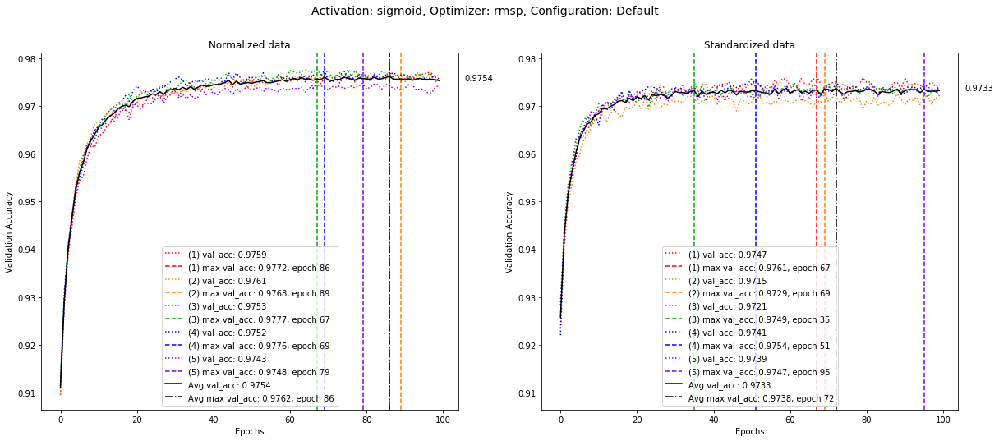

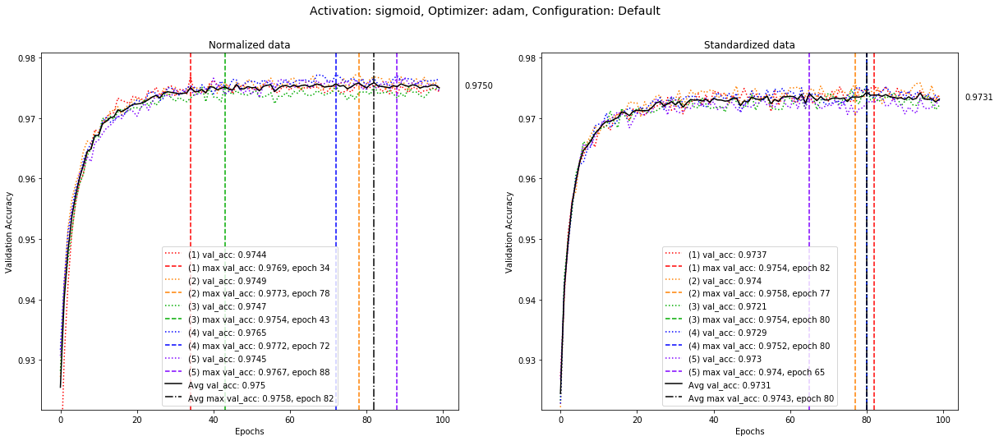

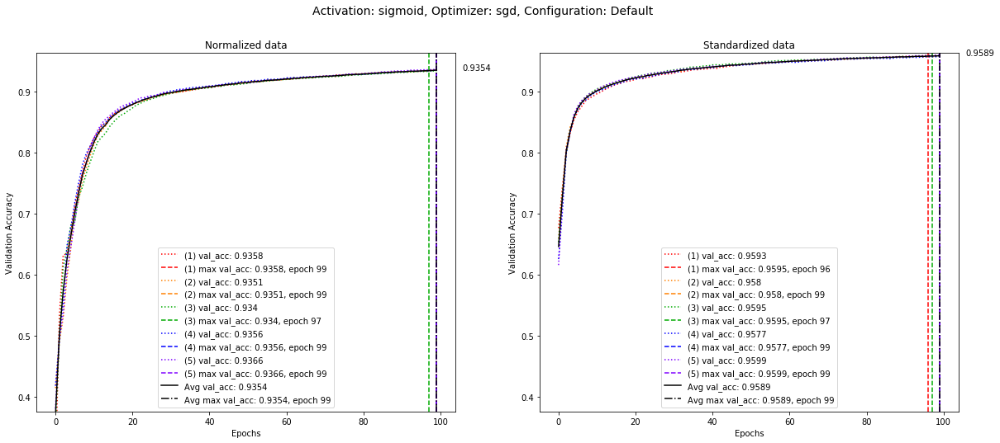

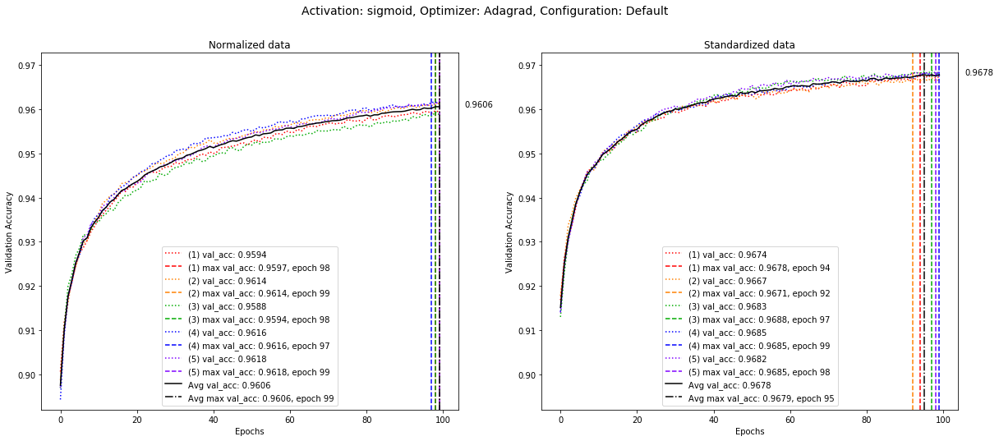

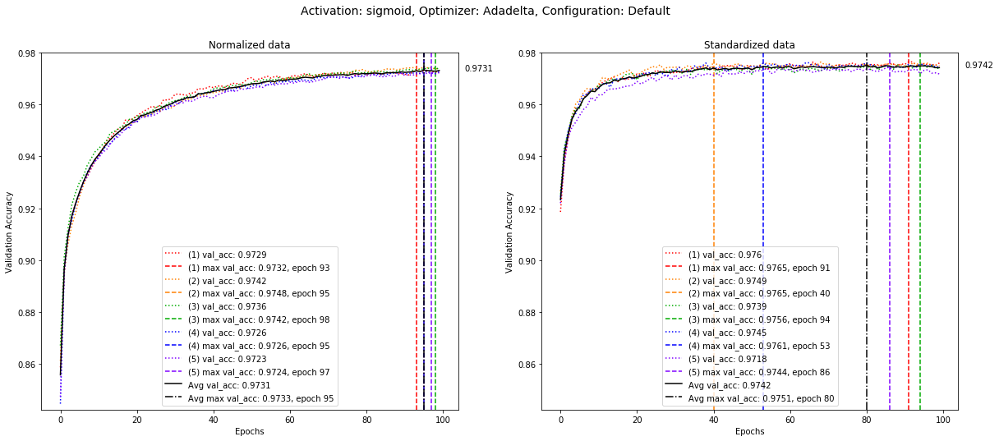

...

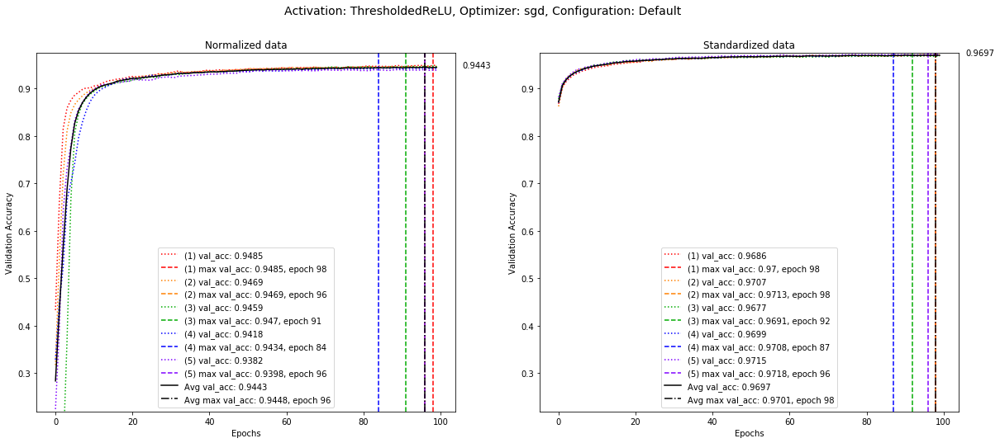

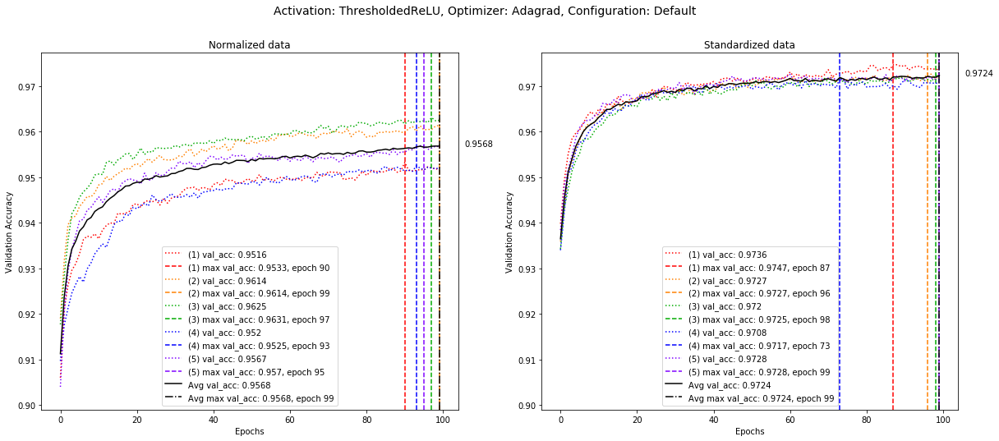

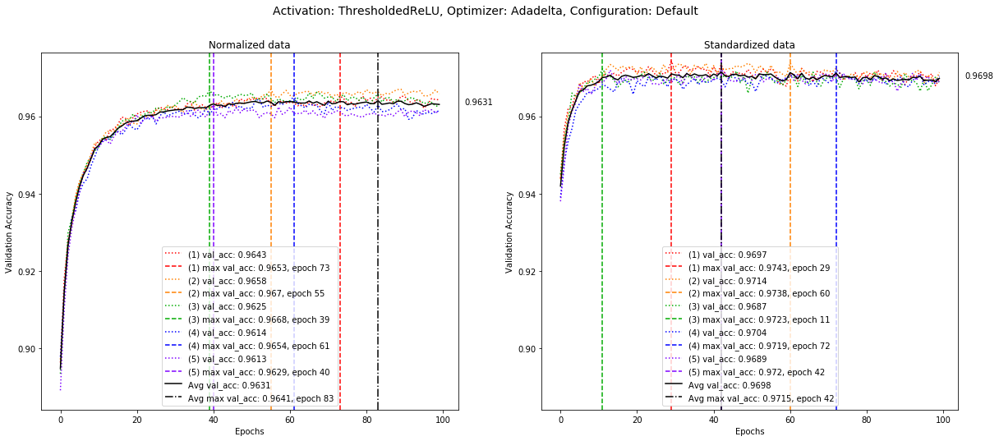

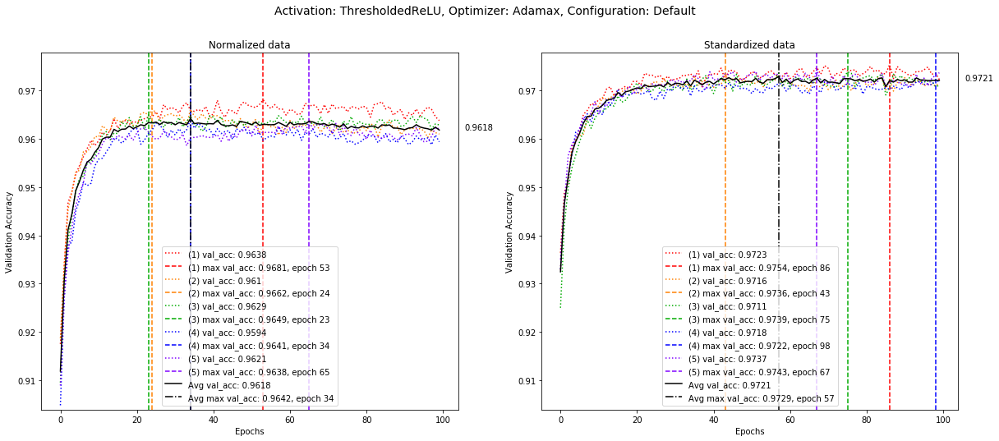

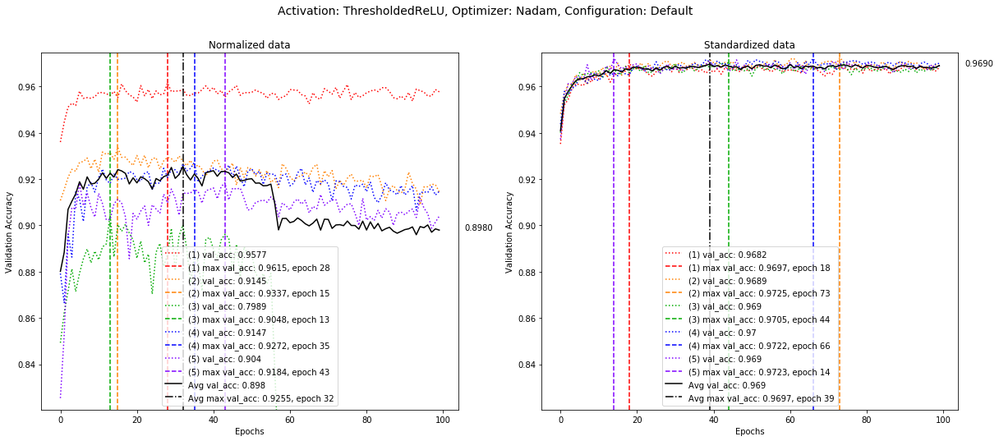

In [16]:
for d in range(len(data_normd)):

    clr = 0
    plt.figure(figsize=(20,8))
    plt.suptitle('Activation: %s, Optimizer: %s, Configuration: %s' % (data_normd[d]['act'], data_normd[d]['opt'], data_normd[d]['opt_cfg']), fontsize=14)
    plt.subplot(1,2,1)
    plt.title(data_label(data_normd[d]['data_type']))

    for i in range(experiments):
        plt.plot(range(epochs),
                 data_normd[d]['data'][i]['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle=':',
                 label='(' + str(i+1) + ') val_acc: ' + str(round(data_normd[d]['data'][i]['val_acc'].tolist()[-1], 4)))
        plt.axvline(x=data_normd[d]['max_val_acc'][i]['epoch'], 
                    label='(' + str(i+1) + ') max val_acc: ' + str(round(data_normd[d]['max_val_acc'][i]['val_acc'], 4)) + ', epoch ' + str(data_normd[d]['max_val_acc'][i]['epoch']),
                   color = colors_new[clr],
                   linestyle='--')
        clr += 1
        if clr > len(colors_new):
            clr = clr % len(colors_new)
    plt.plot(range(epochs),
                 data_normd[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='Avg val_acc: ' + str(round(data_normd[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_normd[d]['max_val_acc']['avg']['epoch'], 
                label='Avg max val_acc: ' + str(round(data_normd[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_normd[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    
    plt.annotate('%0.4f' % data_normd[d]['averaged']['val_acc'].tolist()[-1], 
                 xy=(1, data_normd[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                 xycoords=('axes fraction', 'data'), textcoords='offset points')
    plt.legend(loc='lower center',ncol=1)
    plt.ylim(min([min(data_normd[d]['data'][i]['val_acc'].tolist()), 
                  min(data_std[d]['data'][i]['val_acc'].tolist())]) - 0.005, 
             max([data_normd[d]['max_val_acc']['avg']['val_acc'], 
                  data_std[d]['max_val_acc']['avg']['val_acc']]) + 0.005)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    
    clr = 0
    plt.subplot(1,2,2)
    plt.title(data_label(data_std[d]['data_type']))

    for i in range(experiments):
        plt.plot(range(epochs),
                 data_std[d]['data'][i]['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle=':',
                 label='(' + str(i+1) + ') val_acc: ' + str(round(data_std[d]['data'][i]['val_acc'].tolist()[-1], 4)))
        plt.axvline(x=data_std[d]['max_val_acc'][i]['epoch'], 
                    label='(' + str(i+1) + ') max val_acc: ' + str(round(data_std[d]['max_val_acc'][i]['val_acc'], 4)) + ', epoch ' + str(data_std[d]['max_val_acc'][i]['epoch']),
                   color = colors_new[clr],
                   linestyle='--')
        clr += 1
        if clr > len(colors_new):
            clr = clr % len(colors_new)
    plt.plot(range(epochs),
                 data_std[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='Avg val_acc: ' + str(round(data_std[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_std[d]['max_val_acc']['avg']['epoch'], 
                label='Avg max val_acc: ' + str(round(data_std[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_std[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    
    plt.annotate('%0.4f' % data_std[d]['averaged']['val_acc'].tolist()[-1], 
                 xy=(1, data_std[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                 xycoords=('axes fraction', 'data'), textcoords='offset points')
    plt.legend(loc='lower center',ncol=1)
    plt.ylim(min([min(data_normd[d]['data'][i]['val_acc'].tolist()), 
                  min(data_std[d]['data'][i]['val_acc'].tolist())]) - 0.005, 
             max([data_normd[d]['max_val_acc']['avg']['val_acc'], 
                  data_std[d]['max_val_acc']['avg']['val_acc']]) + 0.005)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')


    plt.show()
    
    

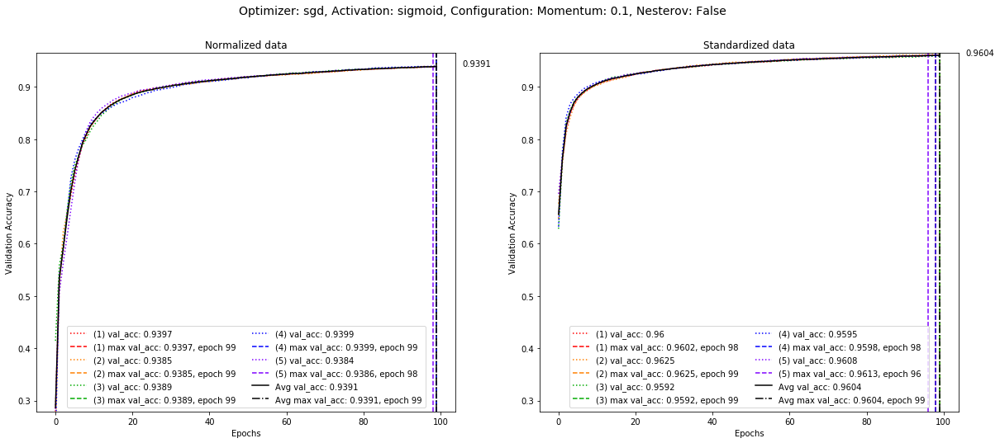

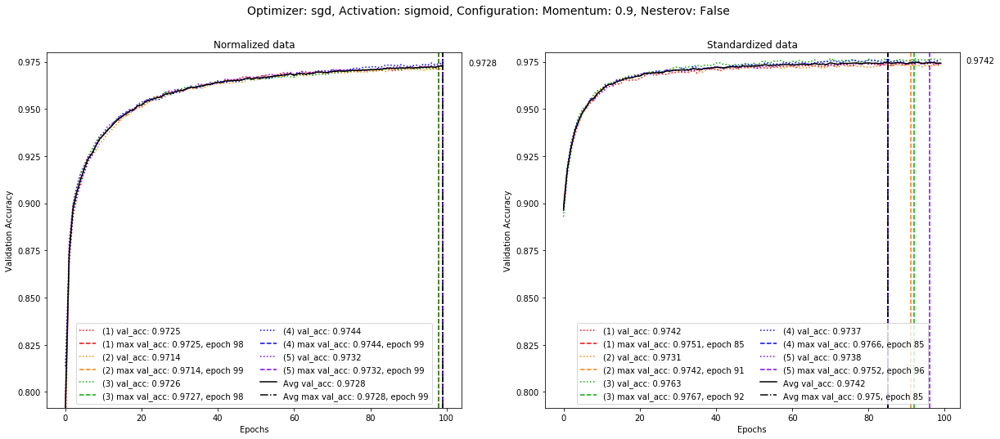

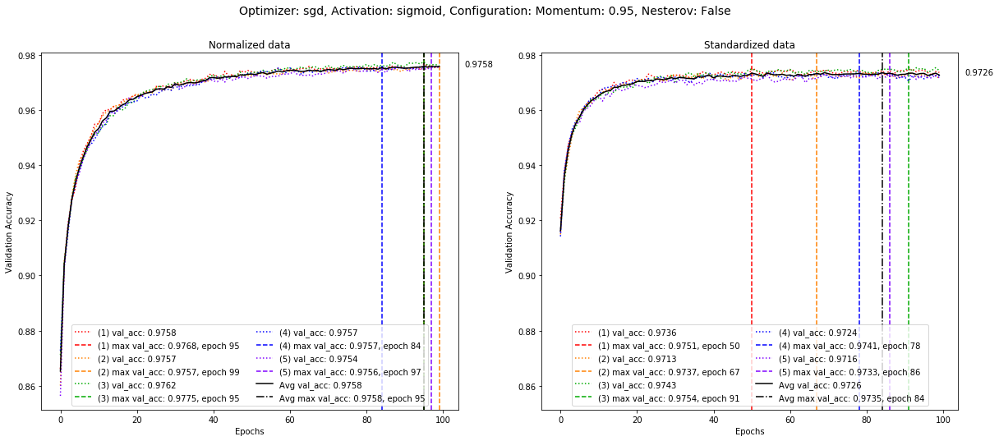

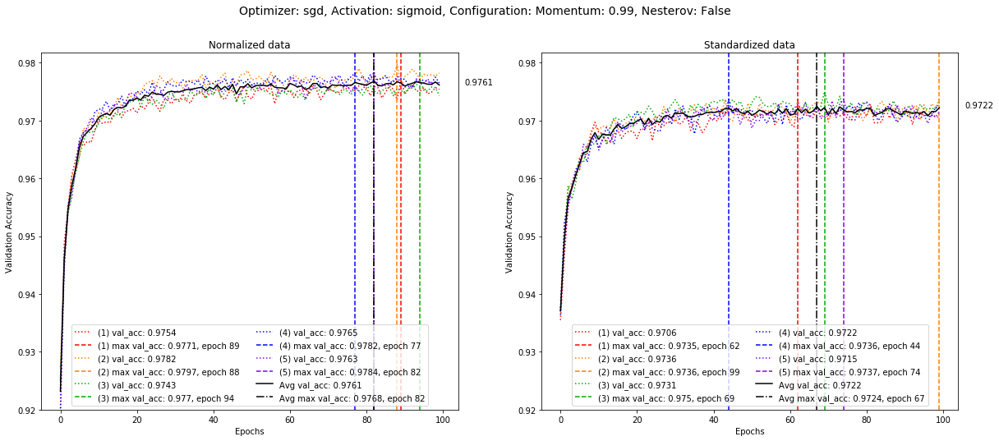

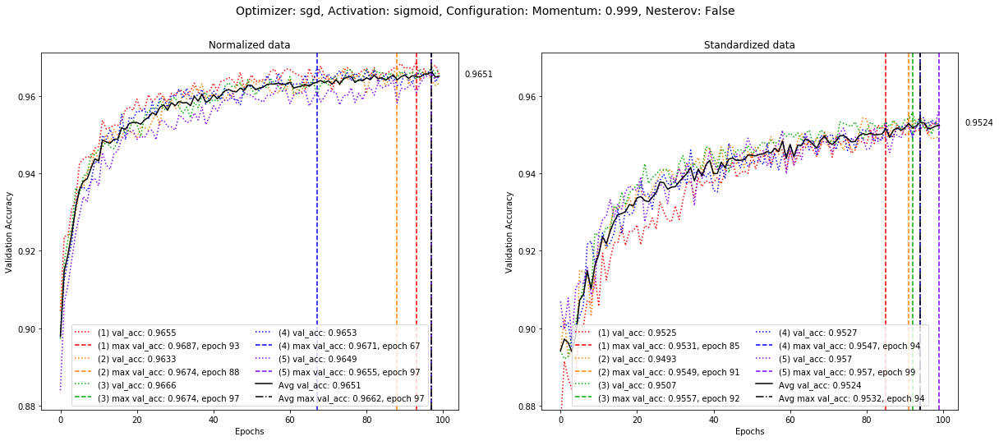

...

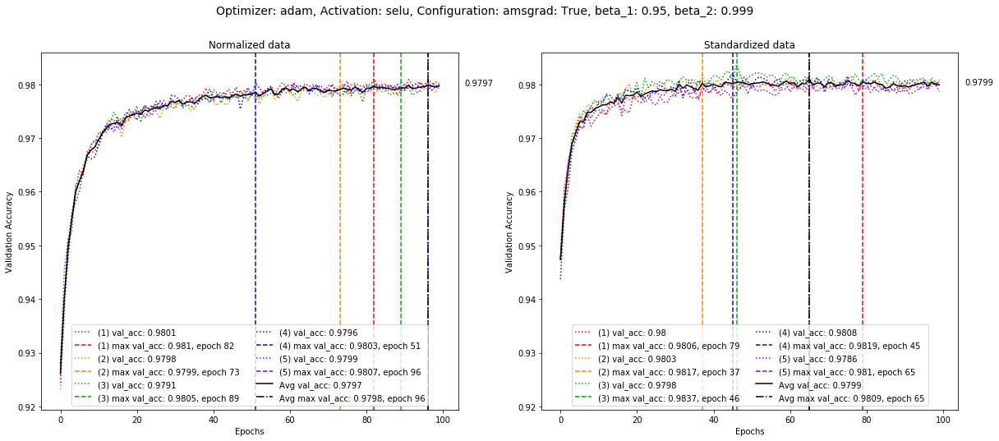

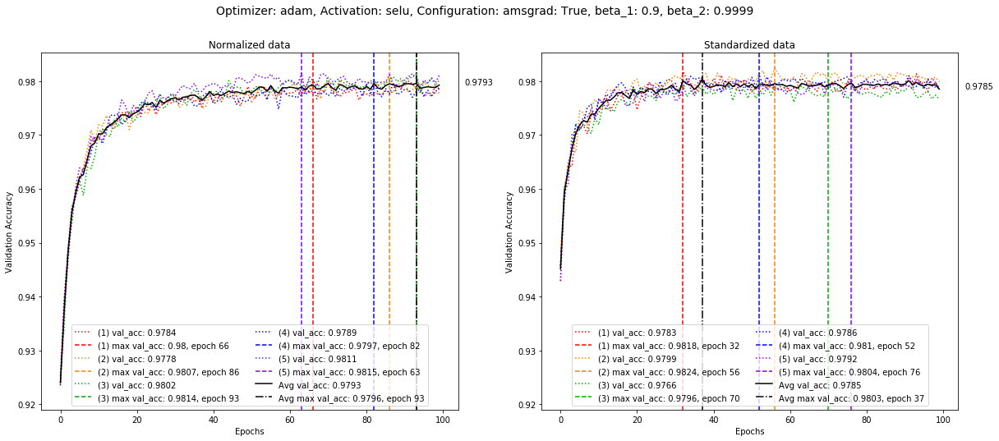

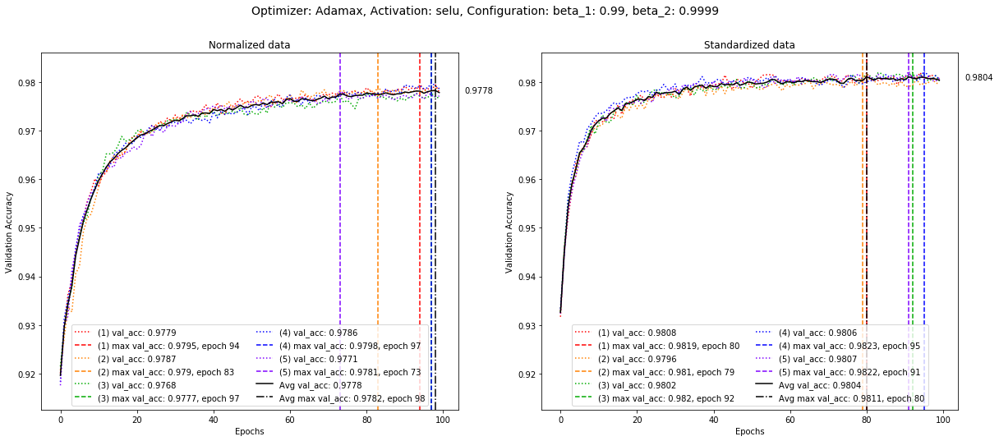

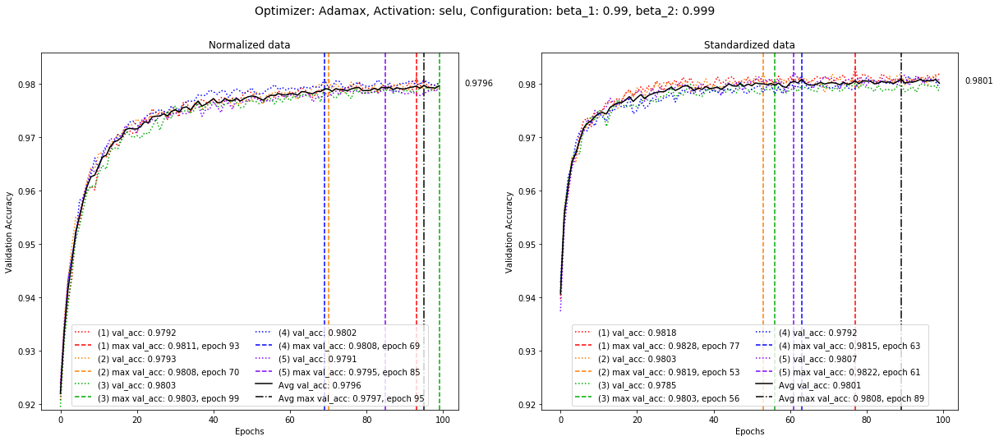

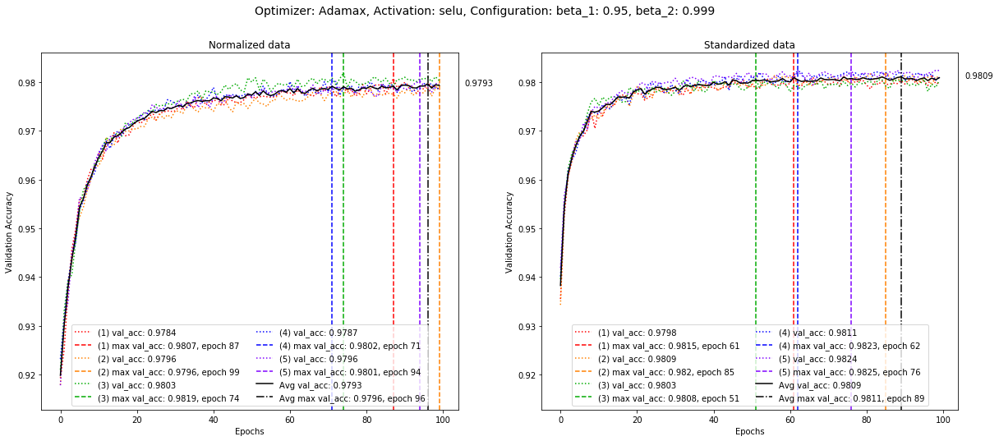

KeyboardInterrupt: 

In [39]:
for d in range(len(data_normd_custom)):

    clr = 0
    plt.figure(figsize=(20,8))
    plt.suptitle('Optimizer: %s, Activation: %s, Configuration: %s' % (data_normd_custom[d]['opt'], data_normd_custom[d]['act'], data_normd_custom[d]['opt_cfg']), fontsize=14)
    plt.subplot(1,2,1)
    plt.title(data_label(data_normd_custom[d]['data_type']))
    for i in range(experiments):
        plt.plot(range(epochs),
                 data_normd_custom[d]['data'][i]['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle=':',
                 label='(' + str(i+1) + ') val_acc: ' + str(round(data_normd_custom[d]['data'][i]['val_acc'].tolist()[-1], 4)))
        plt.axvline(x=data_normd_custom[d]['max_val_acc'][i]['epoch'], 
                    label='(' + str(i+1) + ') max val_acc: ' + str(round(data_normd_custom[d]['max_val_acc'][i]['val_acc'], 4)) + ', epoch ' + str(data_normd_custom[d]['max_val_acc'][i]['epoch']),
                   color = colors_new[clr],
                   linestyle='--')
        clr += 1
        if clr > len(colors_new):
            clr = clr % len(colors_new)
    plt.plot(range(epochs),
                 data_normd_custom[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='Avg val_acc: ' + str(round(data_normd_custom[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_normd_custom[d]['max_val_acc']['avg']['epoch'], 
                label='Avg max val_acc: ' + str(round(data_normd_custom[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_normd_custom[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    
    plt.annotate('%0.4f' % data_normd_custom[d]['averaged']['val_acc'].tolist()[-1], 
                 xy=(1, data_normd_custom[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                 xycoords=('axes fraction', 'data'), textcoords='offset points')
    plt.legend(loc='lower center',ncol=2)
    plt.ylim(min([min(data_normd_custom[d]['data'][i]['val_acc'].tolist()), min(data_std_custom[d]['data'][i]['val_acc'].tolist())]) - 0.005, max([data_normd_custom[d]['max_val_acc']['avg']['val_acc'], data_std_custom[d]['max_val_acc']['avg']['val_acc']]) + 0.005)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    
    clr = 0
    plt.subplot(1,2,2)
    plt.title(data_label(data_std_custom[d]['data_type']))

    for i in range(experiments):
        plt.plot(range(epochs),
                 data_std_custom[d]['data'][i]['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle=':',
                 label='(' + str(i+1) + ') val_acc: ' + str(round(data_std_custom[d]['data'][i]['val_acc'].tolist()[-1], 4)))
        plt.axvline(x=data_std_custom[d]['max_val_acc'][i]['epoch'], 
                    label='(' + str(i+1) + ') max val_acc: ' + str(round(data_std_custom[d]['max_val_acc'][i]['val_acc'], 4)) + ', epoch ' + str(data_std_custom[d]['max_val_acc'][i]['epoch']),
                   color = colors_new[clr],
                   linestyle='--')
        clr += 1
        if clr > len(colors_new):
            clr = clr % len(colors_new)
    plt.plot(range(epochs),
                 data_std_custom[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='Avg val_acc: ' + str(round(data_std_custom[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_std_custom[d]['max_val_acc']['avg']['epoch'], 
                label='Avg max val_acc: ' + str(round(data_std_custom[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_std_custom[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    
    plt.annotate('%0.4f' % data_std_custom[d]['averaged']['val_acc'].tolist()[-1], 
                 xy=(1, data_std_custom[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                 xycoords=('axes fraction', 'data'), textcoords='offset points')
    plt.legend(loc='lower center',ncol=2)
    plt.ylim(min([min(data_normd_custom[d]['data'][i]['val_acc'].tolist()), min(data_std_custom[d]['data'][i]['val_acc'].tolist())]) - 0.005, max([data_normd_custom[d]['max_val_acc']['avg']['val_acc'], data_std_custom[d]['max_val_acc']['avg']['val_acc']]) + 0.005)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    plt.show()
    
    

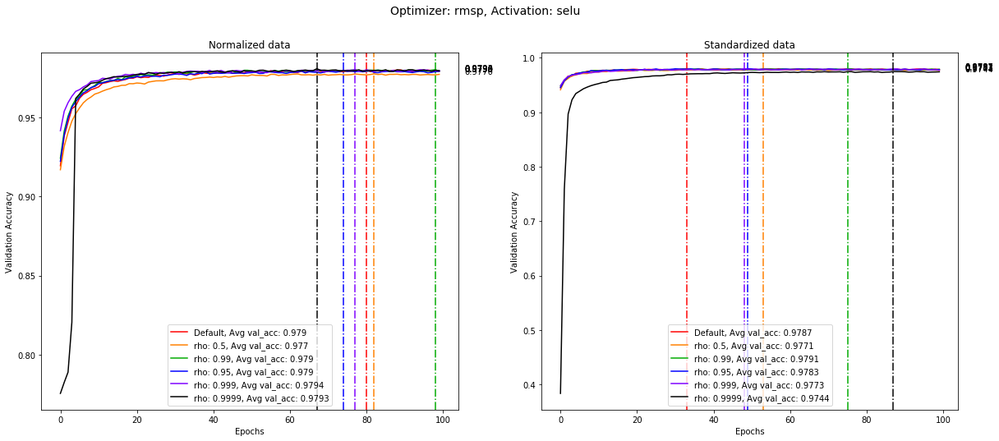

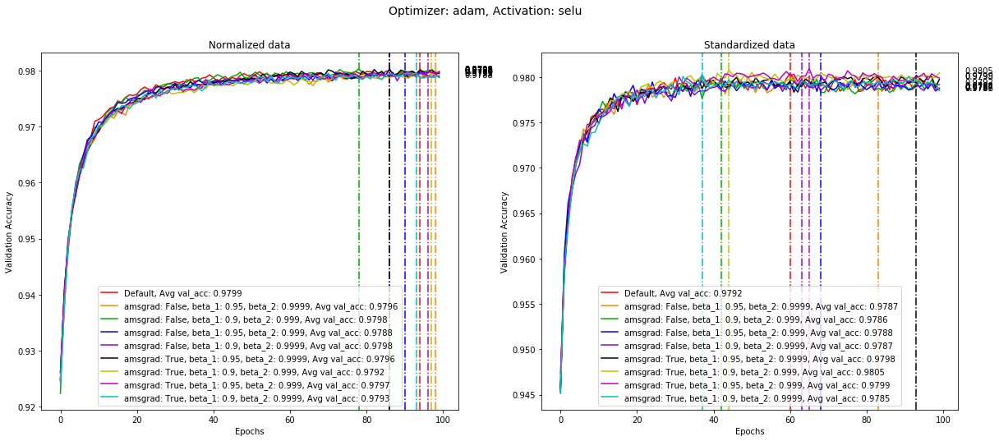

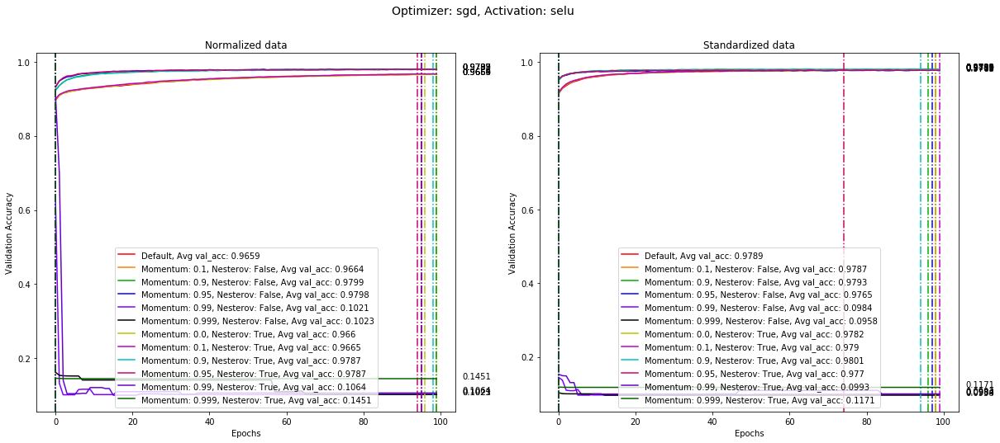

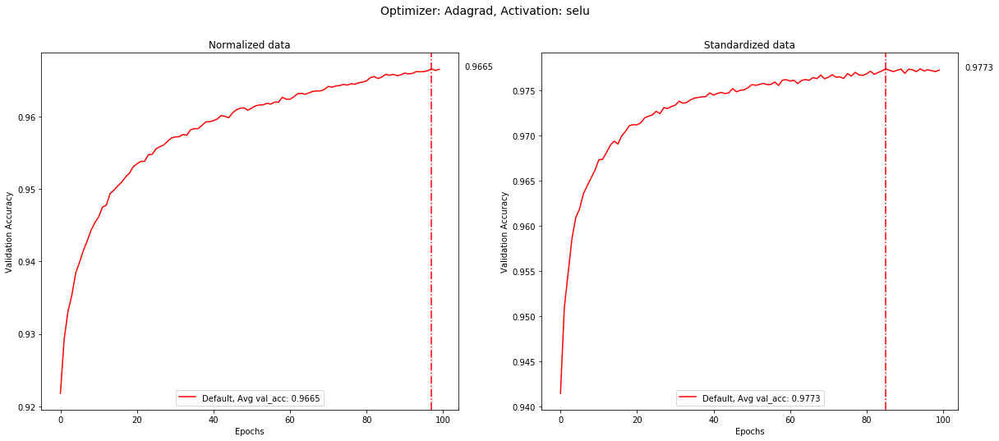

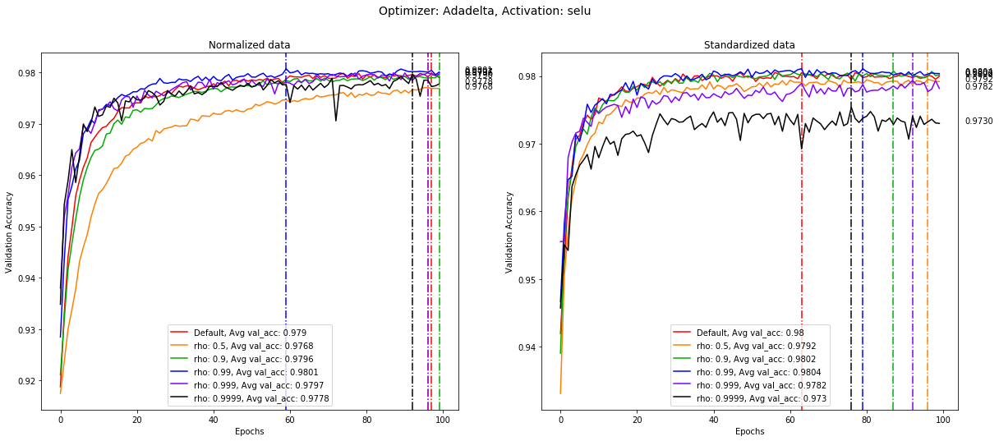

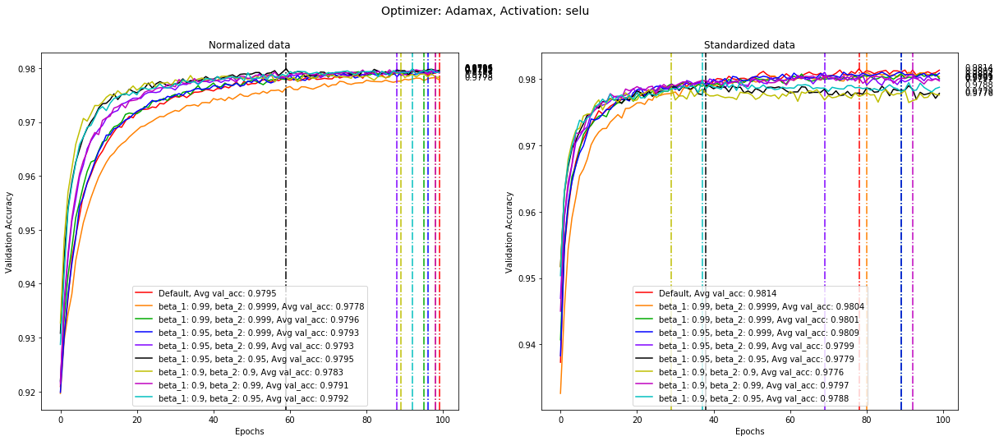

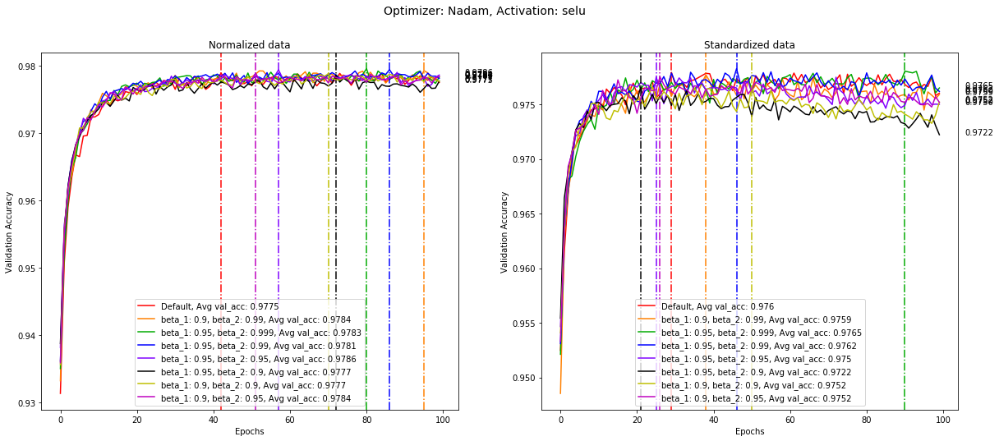

In [40]:
act = 'selu'
for opt in optimizers:
    
    plt.figure(figsize=(20,8))
    clr = 0
    plt.suptitle('Optimizer: %s, Activation: %s' % (opt, act), fontsize=14)
    plt.subplot(1,2,1)
    plt.title("Normalized data")
    
    for d in range(len(data_normd)):

        if data_normd[d]['opt'] == opt and data_normd[d]['act'] == act:
            plt.plot(range(epochs),
                         data_normd[d]['averaged']['val_acc'].tolist(),
                         colors_new[clr],
                         linestyle='-',
                         label=data_normd[d]['opt_cfg'] + ', Avg val_acc: ' + str(round(data_normd[d]['averaged']['val_acc'].tolist()[-1], 4)))
            plt.axvline(x=data_normd[d]['max_val_acc']['avg']['epoch'], 
                        #label='Avg max val_acc: ' + str(round(data_normd[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_normd[d]['max_val_acc']['avg']['epoch']),
                        color = colors_new[clr],                   
                        linestyle='-.')

            plt.annotate('%0.4f' % data_normd[d]['averaged']['val_acc'].tolist()[-1], 
                         xy=(1, data_normd[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                         xycoords=('axes fraction', 'data'), textcoords='offset points')
            clr+=1
        
    for d in range(len(data_normd_custom)):

        if data_normd_custom[d]['opt'] == opt and data_normd_custom[d]['act'] == act:
            plt.plot(range(epochs),
                         data_normd_custom[d]['averaged']['val_acc'].tolist(),
                         colors_new[clr],
                         linestyle='-',
                         label=data_normd_custom[d]['opt_cfg'] + ', Avg val_acc: ' + str(round(data_normd_custom[d]['averaged']['val_acc'].tolist()[-1], 4)))
            plt.axvline(x=data_normd_custom[d]['max_val_acc']['avg']['epoch'], 
                        #label='Avg max val_acc: ' + str(round(data_normd_custom[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_normd_custom[d]['max_val_acc']['avg']['epoch']),
                        color = colors_new[clr],                   
                        linestyle='-.')

            plt.annotate('%0.4f' % data_normd_custom[d]['averaged']['val_acc'].tolist()[-1], 
                         xy=(1, data_normd_custom[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                         xycoords=('axes fraction', 'data'), textcoords='offset points')    
            clr+=1
        
    plt.legend(loc='lower center',ncol=1)
#     plt.ylim(min([min(data_normd[d]['data'][i]['val_acc'].tolist()), 
#                   min(data_std[d]['data'][i]['val_acc'].tolist())]) - 0.005, 
#              max([data_normd[d]['max_val_acc']['avg']['val_acc'], 
#                   data_std[d]['max_val_acc']['avg']['val_acc']]) + 0.005)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')

    clr = 0
    plt.subplot(1,2,2)
    plt.title('Standardized data')

    for d in range(len(data_std)):

        if data_std[d]['opt'] == opt and data_std[d]['act'] == act:
            plt.plot(range(epochs),
                         data_std[d]['averaged']['val_acc'].tolist(),
                         colors_new[clr],
                         linestyle='-',
                         label=data_std[d]['opt_cfg'] + ', Avg val_acc: ' + str(round(data_std[d]['averaged']['val_acc'].tolist()[-1], 4)))
            plt.axvline(x=data_std[d]['max_val_acc']['avg']['epoch'], 
                        #label='Avg max val_acc: ' + str(round(data_std[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_std[d]['max_val_acc']['avg']['epoch']),
                        color = colors_new[clr],                   
                        linestyle='-.')

            plt.annotate('%0.4f' % data_std[d]['averaged']['val_acc'].tolist()[-1], 
                         xy=(1, data_std[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                         xycoords=('axes fraction', 'data'), textcoords='offset points')
            clr+=1
        
    for d in range(len(data_std_custom)):

        if data_std_custom[d]['opt'] == opt and data_std_custom[d]['act'] == act:
            plt.plot(range(epochs),
                         data_std_custom[d]['averaged']['val_acc'].tolist(),
                         colors_new[clr],
                         linestyle='-',
                         label=data_std_custom[d]['opt_cfg'] + ', Avg val_acc: ' + str(round(data_std_custom[d]['averaged']['val_acc'].tolist()[-1], 4)))
            plt.axvline(x=data_std_custom[d]['max_val_acc']['avg']['epoch'], 
                        #label='Avg max val_acc: ' + str(round(data_std_custom[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_std_custom[d]['max_val_acc']['avg']['epoch']),
                        color = colors_new[clr],                   
                        linestyle='-.')

            plt.annotate('%0.4f' % data_std_custom[d]['averaged']['val_acc'].tolist()[-1], 
                         xy=(1, data_std_custom[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                         xycoords=('axes fraction', 'data'), textcoords='offset points')   
            clr+=1
        
    plt.legend(loc='lower center',ncol=1)
#     plt.ylim(min([min(data_std[d]['data'][i]['val_acc'].tolist()), 
#                   min(data_std[d]['data'][i]['val_acc'].tolist())]) - 0.005, 
#              max([data_std[d]['max_val_acc']['avg']['val_acc'], 
#                   data_std[d]['max_val_acc']['avg']['val_acc']]) + 0.005)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')


    plt.show()

